In [ ]:
import torch

if torch.cuda.is_available():
    print(f"Using GPU: {torch.cuda.get_device_name(0)}")
else:
    print("GPU not available, using CPU")

Using GPU: NVIDIA L4


100%|██████████| 170498071/170498071 [00:02<00:00, 82262348.10it/s]


Streaming output truncated to the last 5000 lines.
Train Epoch: 236 	Model: 2 	Training Loss: 6875.417801410646 	Temperature Strategy: linear_increase 	tau_1: 129.8146209716797 	tau_2: 129.8146209716797
Train Epoch: 236 	Model: 3 	Training Loss: 7013.551134660725 	Temperature Strategy: linear_decrease 	tau_1: 94.81779479980469 	tau_2: 94.81779479980469
Train Epoch: 236 	Model: 4 	Training Loss: 6865.638690607017 	Temperature Strategy: exp_increase 	tau_1: 201.56561279296875 	tau_2: 201.56561279296875
Train Epoch: 236 	Model: 5 	Training Loss: 6924.901886688779 	Temperature Strategy: exp_decrease 	tau_1: 93.17750549316406 	tau_2: 93.17750549316406
Train Epoch: 236 	Model: 6 	Training Loss: 6902.107416879795 	Temperature Strategy: fixed 	tau_1: 98.41561126708984 	tau_2: 98.41561126708984
Train Epoch: 236 	Model: 7 	Training Loss: 6864.913893911845 	Temperature Strategy: linear_increase 	tau_1: 179.86370849609375 	tau_2: 179.86370849609375
Train Epoch: 236 	Model: 8 	Training Loss: 6931.6

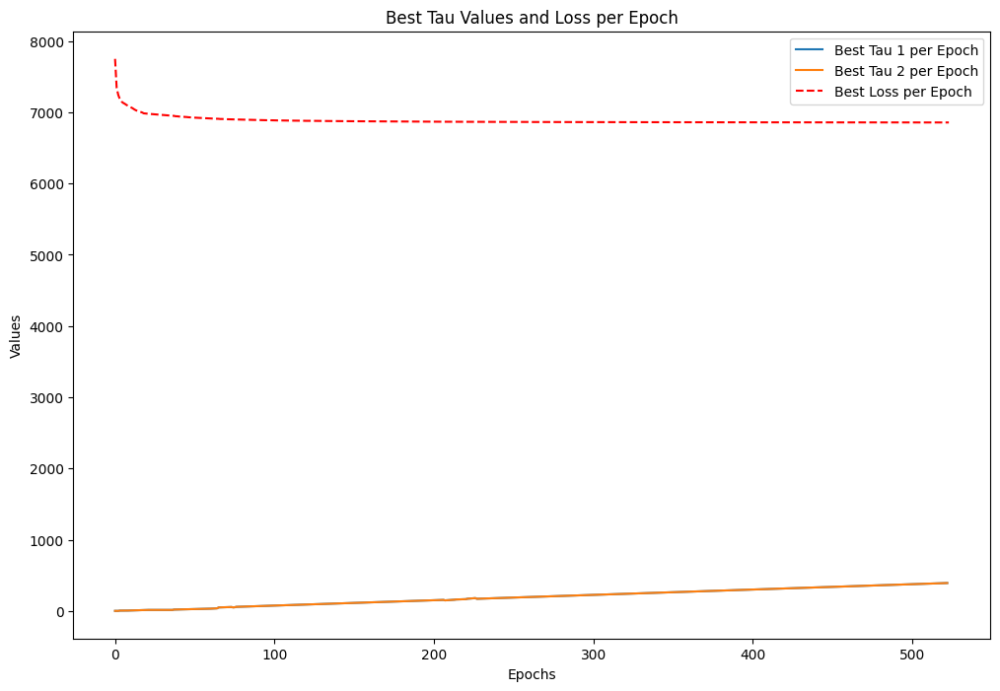

In [ ]:
# Our proposed model using linear increasing tau on CIFAR-10
# The models are trained by using full dataset
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.transforms as transforms
import torchvision.datasets as datasets
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
import copy
import numpy as np
import os
import torch.nn.functional as F
import torch.utils.data.dataloader as dataloader
import torch.optim as optim
from torch.utils.data import TensorDataset
from torch.autograd import Variable
from torchvision import transforms
from torchvision.datasets import CelebA
from torch import optim
from torch.utils import data as dataloader


SEED = 1
torch.manual_seed(SEED)
cuda = torch.cuda.is_available()
device = torch.device('cuda' if cuda else 'cpu')
SAVE_PATH = "/content/sample_data/best_model_cifar10_parallel_desktop2070_August_16.pth"
BATCH_SIZE = 128
Z_DIM = 300
LOG_INTERVAL = 50

# Define the transform for image preprocessing
transform = transforms.Compose([
    transforms.Resize((64, 64)),
    transforms.ToTensor()
])

# Download and load the CIFAR-10 dataset
train_dataset = datasets.CIFAR10('./data', train=True, transform=transform, download=True)
test_dataset = datasets.CIFAR10('./data', train=False, transform=transform, download=True)

# Create data loaders
train_loader = DataLoader(train_dataset, shuffle=True, batch_size=BATCH_SIZE, num_workers=4, pin_memory=True)
test_loader = DataLoader(test_dataset, shuffle=False, batch_size=BATCH_SIZE, num_workers=4, pin_memory=True)


def plot_images(original_images, reconstructed_images, n=10):
    original_images = original_images.cpu().numpy().squeeze()
    reconstructed_images = reconstructed_images.cpu().detach().numpy().squeeze()

    plt.figure(figsize=(20, 4))
    for i in range(n):
        # Display original images
        ax = plt.subplot(2, n, i + 1)
        plt.imshow(original_images[i], cmap='gray')
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

        # Display reconstruction images
        ax = plt.subplot(2, n, i + 1 + n)
        plt.imshow(reconstructed_images[i], cmap='gray')
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)
    plt.show()


# Define the GumbelSoftmaxVAE model
class GumbelSoftmaxVAE(nn.Module):
    def __init__(self, tau_1=1.0, tau_2=1.0):
        super().__init__()

        self.tau_1 = tau_1
        self.tau_2 = tau_2

        # Encoder
        self.conv1 = nn.Conv2d(3, 32, kernel_size=4, stride=2, padding=1)
        self.conv2 = nn.Conv2d(32, 64, kernel_size=4, stride=2, padding=1)
        self.conv3 = nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1)
        self.conv4 = nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1)

        # Two layers of latent variables
        self.fc_logits_z1 = nn.Linear(256 * 4 * 4, Z_DIM)
        self.fc_logits_z2 = nn.Linear(Z_DIM, Z_DIM)

        # Decoder for each layer
        self.fc_dec1 = nn.Linear(Z_DIM, 256 * 4 * 4)
        self.fc_dec2 = nn.Linear(Z_DIM, 128 * 8 * 8)

        self.conv_trans1_1 = nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1)
        self.conv_trans2_1 = nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1)
        self.conv_trans3_1 = nn.ConvTranspose2d(64, 32, kernel_size=4, stride=2, padding=1)
        self.conv_trans4_1 = nn.ConvTranspose2d(32, 3, kernel_size=4, stride=2, padding=1)

        self.conv_trans1_2 = nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1)
        self.conv_trans2_2 = nn.ConvTranspose2d(64, 32, kernel_size=4, stride=2, padding=1)
        self.conv_trans3_2 = nn.ConvTranspose2d(32, 3, kernel_size=4, stride=2, padding=1)

    def encode(self, x):
        x = F.relu(self.conv1(x))
        x = F.relu(self.conv2(x))
        x = F.relu(self.conv3(x))
        x = F.relu(self.conv4(x))
        x = x.view(x.size(0), -1)

        logits_z1 = self.fc_logits_z1(x)
        logits_z2 = self.fc_logits_z2(logits_z1)

        return logits_z1, logits_z2

    def reparameterize(self, logits, tau):
        gumbel_noise = torch.rand_like(logits).to(device)
        gumbel_noise = -torch.log(-torch.log(gumbel_noise + 1e-8) + 1e-8)
        z = (logits + gumbel_noise) / tau
        z = F.softmax(z, dim=-1)
        return z

    def decode1(self, z):
        z = self.fc_dec1(z)
        z = z.view(z.size(0), 256, 4, 4)  # reshape
        z = F.relu(self.conv_trans1_1(z))
        z = F.relu(self.conv_trans2_1(z))
        z = F.relu(self.conv_trans3_1(z))
        z = torch.tanh(self.conv_trans4_1(z))
        z = torch.clamp(z, 0, 1)  # Clamp the values between 0 and 1
        return z

    def decode2(self, z):
        z = self.fc_dec2(z)
        z = z.view(z.size(0), 128, 8, 8)  # reshape
        z = F.relu(self.conv_trans1_2(z))
        z = F.relu(self.conv_trans2_2(z))
        z = torch.sigmoid(self.conv_trans3_2(z))
        z = torch.clamp(z, 0, 1)  # Clamp the values between 0 and 1
        return z

    def forward(self, x):
        logits_z1, logits_z2 = self.encode(x)
        z1 = self.reparameterize(logits_z1, self.tau_1)
        z2 = self.reparameterize(logits_z2, self.tau_2)

        x_hat1 = self.decode1(z1)
        x_hat2 = self.decode2(z2)

        # Average the output of the two decoders
        x_hat = (x_hat1 + x_hat2) / 2.0

        return x_hat, logits_z1, logits_z2, z1, z2

    def gumbel_softmax_loss_function(self, recon_x, x, logits_z1, logits_z2, z1, z2):
        # Clamp the values of recon_x between 0 and 1
        recon_x = torch.clamp(recon_x, 0, 1)
        # Binary cross entropy
        xent_loss = F.binary_cross_entropy(recon_x, x, reduction='none')
        xent_loss = torch.sum(xent_loss, dim=[1, 2, 3])

        # KL divergence for each layer
        p_z1 = F.softmax(logits_z1, dim=-1)
        p_z1 = torch.clamp(p_z1, torch.finfo(p_z1.dtype).eps, 1. - torch.finfo(p_z1.dtype).eps)  # to prevent log(0)
        kl_loss_z1 = torch.sum(p_z1 * torch.log(p_z1 * Z_DIM + torch.finfo(p_z1.dtype).eps), dim=-1)

        p_z2 = F.softmax(logits_z2, dim=-1)
        p_z2 = torch.clamp(p_z2, torch.finfo(p_z2.dtype).eps, 1. - torch.finfo(p_z2.dtype).eps)  # to prevent log(0)
        kl_loss_z2 = torch.sum(p_z2 * torch.log(p_z2 * Z_DIM + torch.finfo(p_z2.dtype).eps), dim=-1)

        # Total loss is the sum of the losses for each layer
        vae_loss = torch.mean(xent_loss + kl_loss_z1 + kl_loss_z2)
        return vae_loss


initial_tau_1 = 1.0
initial_tau_2 = 1.0
NUM_EPOCHS = 1000
LOG_INTERVAL = 50
NUM_MODELS = 11
LOSS_THRESHOLD = 0.0001
EARLY_STOP_PATIENCE = 15  # Early stopping patience
initial_taus = [initial_tau_1, initial_tau_2]

models = [GumbelSoftmaxVAE().to(device) for _ in range(NUM_MODELS)]
optimizers = [optim.Adam(model.parameters(), lr=1e-3) for model in models]

temp_strategies = ['fixed', 'linear_increase', 'linear_decrease', 'exp_increase', 'exp_decrease']
temp_strategies_extended = ['fixed'] + temp_strategies * ((NUM_MODELS - 1) // len(temp_strategies)) + temp_strategies[:((NUM_MODELS - 1) % len(temp_strategies))]
tau_min, tau_max = 0.00001, 900000

num_fixed = temp_strategies_extended.count('fixed')
num_linear_increase = temp_strategies_extended.count('linear_increase')
num_linear_decrease = temp_strategies_extended.count('linear_decrease')
num_exp_increase = temp_strategies_extended.count('exp_increase')
num_exp_decrease = temp_strategies_extended.count('exp_decrease')

lin_increase_values = [0.5 + i * 0.25 for i in range(num_linear_increase)]
lin_decrease_values = [0.002 * (2 ** i) for i in range(num_linear_decrease)]
exp_increase_values = [1.01 + i * 0.02 for i in range(num_exp_increase)]
exp_decrease_values = [0.999 - i * 0.001 for i in range(num_exp_decrease)]

taus_1 = []
taus_2 = []

best_tau_per_epoch_1 = []
best_tau_per_epoch_2 = []
best_losses_per_epoch = []

for i in range(NUM_MODELS):
    temp_strategy = temp_strategies_extended[i]

    if temp_strategy == 'fixed':

        tau = torch.tensor(float(0.5 * (i + 1)), requires_grad=True).to(device)
    else:

        tau = torch.tensor(1.0, requires_grad=True).to(device)

    taus_1.append(tau)
    taus_2.append(tau)


assert len(temp_strategies_extended) == NUM_MODELS, f"Expected {NUM_MODELS} strategies, got {len(temp_strategies_extended)}"

best_global_loss = float('inf')
early_stop_counter = 0
learning_rate = 0.01
patience_threshold = 3
patience_counter = [0 for _ in range(NUM_MODELS)]


for epoch in range(NUM_EPOCHS):
    losses = []
    best_reconstruction = None
    original_images = None

    for i in range(NUM_MODELS):
        temp_strategy = temp_strategies_extended[i]
        if temp_strategy == 'linear_increase':
            lin_increase = lin_increase_values[i % len(lin_increase_values)]
            taus_1[i] = torch.tensor(float(min(taus_1[i].item() + lin_increase, tau_max)), requires_grad=True).to(device)
            taus_2[i] = torch.tensor(float(min(taus_2[i].item() + lin_increase, tau_max)), requires_grad=True).to(device)
        elif temp_strategy == 'linear_decrease':
            lin_decrease = lin_decrease_values[i % len(lin_decrease_values)]
            taus_1[i] = torch.tensor(float(max(taus_1[i].item() - lin_decrease, tau_min)), requires_grad=True).to(device)
            taus_2[i] = torch.tensor(float(max(taus_2[i].item() - lin_decrease, tau_min)), requires_grad=True).to(device)
        elif temp_strategy == 'exp_increase':
            exp_increase = exp_increase_values[i % len(exp_increase_values)]
            taus_1[i] = torch.tensor(float(min(taus_1[i].item() * exp_increase, tau_max)), requires_grad=True).to(device)
            taus_2[i] = torch.tensor(float(min(taus_2[i].item() * exp_increase, tau_max)), requires_grad=True).to(device)
        elif temp_strategy == 'exp_decrease':
            exp_decrease = exp_decrease_values[i % len(exp_decrease_values)]
            taus_1[i] = torch.tensor(float(max(taus_1[i].item() * exp_decrease, tau_min)), requires_grad=True).to(device)
            taus_2[i] = torch.tensor(float(max(taus_2[i].item() * exp_decrease, tau_min)), requires_grad=True).to(device)

        models[i].tau_1 = taus_1[i]
        models[i].tau_2 = taus_2[i]

    for i in range(NUM_MODELS):
        model = models[i]
        epoch_loss = 0.0

        for batch_idx, (data, _) in enumerate(train_loader):
            data = data.to(device)
            optimizers[i].zero_grad()
            recon_batch, logits_z1, logits_z2, z1, z2 = model(data)
            loss = model.gumbel_softmax_loss_function(recon_batch, data, logits_z1, logits_z2, z1, z2)
            loss.backward()
            optimizers[i].step()
            epoch_loss += loss.item()

            if epoch_loss < LOSS_THRESHOLD and (best_reconstruction is None or loss.item() < min(losses)):
                best_reconstruction = recon_batch
                original_images = data

        epoch_loss /= len(train_loader)
        losses.append(epoch_loss)
        print(f'Train Epoch: {epoch} \tModel: {i} \tTraining Loss: {epoch_loss} \tTemperature Strategy: {temp_strategies_extended[i]} \ttau_1: {models[i].tau_1.item()} \ttau_2: {models[i].tau_2.item()}')

    best_model_idx = np.argmin(losses)
    best_loss = losses[best_model_idx]
    best_losses_per_epoch.append(best_loss)


    if best_loss < best_global_loss:
        best_global_loss = best_loss
        best_model_state_dict = copy.deepcopy(models[best_model_idx].state_dict())
        torch.save(models[best_model_idx].state_dict(), SAVE_PATH)
        print(f'Best model saved with index: {best_model_idx} and loss: {best_loss}')
        early_stop_counter = 0

    for i in range(NUM_MODELS):
        if i != best_model_idx:
            models[i].load_state_dict(best_model_state_dict, strict=False)

    for i in range(NUM_MODELS):
        if i != best_model_idx:
            if losses[i] > best_loss:
                patience_counter[i] += 1
                if patience_counter[i] >= patience_threshold:
                    delta_tau = learning_rate * (losses[i] - best_loss)
                    print(delta_tau)
                    taus_1[i] = torch.tensor(float(min(taus_1[i].item() + delta_tau, tau_max)), requires_grad=True).to(device)
                    taus_2[i] = torch.tensor(float(min(taus_2[i].item() + delta_tau, tau_max)), requires_grad=True).to(device)
                    models[i].tau_1 = taus_1[i]
                    models[i].tau_2 = taus_2[i]
                    patience_counter[i] = 0
            else:
                patience_counter[i] = 0

    early_stop_counter += 1


    if early_stop_counter >= EARLY_STOP_PATIENCE:
        print(f'Early stopping triggered after {epoch + 1} epochs.')
        break

    best_tau_per_epoch_1.append(models[best_model_idx].tau_1.item())
    best_tau_per_epoch_2.append(models[best_model_idx].tau_2.item())

    print(f'Epoch: {epoch} \tBest Model Index: {best_model_idx} \tBest Temperature Strategy: {temp_strategies_extended[best_model_idx]} \tBest tau_1: {models[best_model_idx].tau_1.item()} \tBest tau_2: {models[best_model_idx].tau_2.item()}')

    if best_reconstruction is not None and original_images is not None:
        plot_images(original_images.cpu(), best_reconstruction.cpu())

for epoch, (tau_1, tau_2, loss) in enumerate(zip(best_tau_per_epoch_1, best_tau_per_epoch_2, best_losses_per_epoch)):
    print(f"Epoch: {epoch}, Best Tau 1: {tau_1}, Best Tau 2: {tau_2}, Best Loss: {loss}")

plt.figure(figsize=(12, 8))
plt.plot(range(len(best_tau_per_epoch_1)), best_tau_per_epoch_1, label='Best Tau 1 per Epoch')
plt.plot(range(len(best_tau_per_epoch_2)), best_tau_per_epoch_2, label='Best Tau 2 per Epoch')
plt.plot(range(len(best_losses_per_epoch)), best_losses_per_epoch, label='Best Loss per Epoch', linestyle='--', color='red')
plt.xlabel('Epochs')
plt.ylabel('Values')
plt.title('Best Tau Values and Loss per Epoch')
plt.legend()
plt.show()


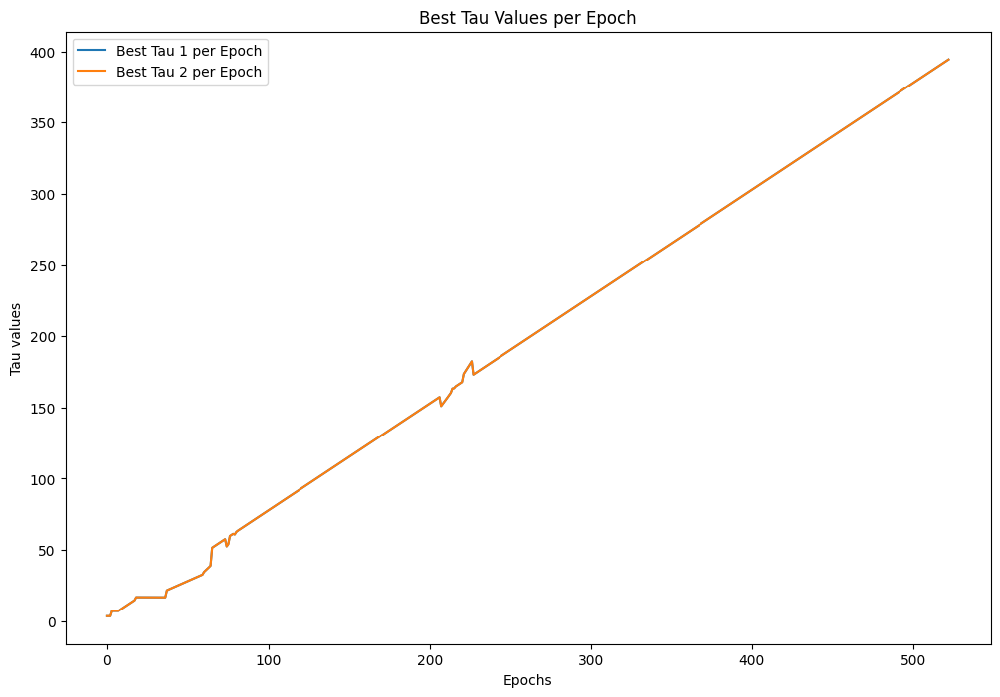

In [ ]:
# Plot the best_tau_per_epoch
plt.figure(figsize=(12, 8))
plt.plot(range(len(best_tau_per_epoch_1)), best_tau_per_epoch_1, label='Best Tau 1 per Epoch')
plt.plot(range(len(best_tau_per_epoch_2)), best_tau_per_epoch_2, label='Best Tau 2 per Epoch')
plt.xlabel('Epochs')
plt.ylabel('Tau values')
plt.title('Best Tau Values per Epoch')
plt.legend()
plt.show()


MSE Loss: 0.000897212652489543


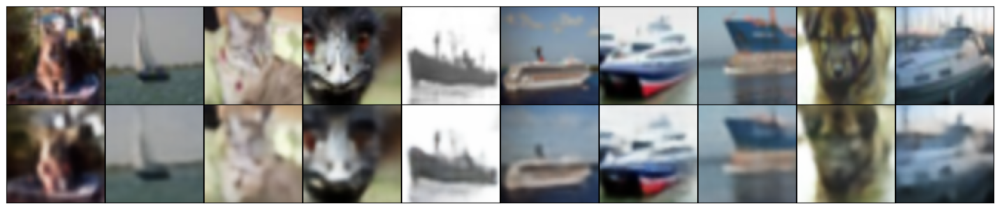

Pixel Error: 2.129046246409416%


In [ ]:
# Test our proposed model's MSE on CIFAR-10
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt
from torchvision.utils import make_grid
import numpy as np

# Function to calculate MSE loss
def calculate_mse(original, reconstructed):
    mse_loss = F.mse_loss(reconstructed, original, reduction='mean')
    return mse_loss.item()

# Function to calculate FID score
def calculate_fid(real_features, fake_features):
    mu1, mu2 = np.mean(real_features, axis=0), np.mean(fake_features, axis=0)
    sigma1, sigma2 = np.cov(real_features, rowvar=False), np.cov(fake_features, rowvar=False)
    diff = np.sum((mu1 - mu2) ** 2.0)
    covmean = np.linalg.sqrt(sigma1.dot(sigma2))
    fid = diff + np.trace(sigma1 + sigma2 - 2.0 * covmean)
    return fid

# Function to calculate pixel error
def calculate_pixel_error(original, reconstructed):
    pixel_error = torch.mean(torch.abs(original - reconstructed)).item()
    return pixel_error * 100  # Convert to percentage

# Function to plot images without white spaces
def plot_images(original_images, reconstructed_images, n=15):
    # Convert tensors to numpy arrays
    original_images_np = original_images.cpu().numpy()
    reconstructed_images_np = reconstructed_images.cpu().detach().numpy()

    plt.figure(figsize=(20, 4))
    for i in range(n):
        # Plot original images
        ax = plt.subplot(2, n, i + 1)
        plt.imshow(np.transpose(original_images_np[i], (1, 2, 0)))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

        # Plot reconstructed images
        ax = plt.subplot(2, n, i + n + 1)
        plt.imshow(np.transpose(reconstructed_images_np[i], (1, 2, 0)))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

    plt.subplots_adjust(wspace=0, hspace=0)
    plt.show()


data, _ = next(iter(test_loader))
data = data.to(device)

# Randomly select n images
indices = torch.randperm(len(data))[:15]
selected_data = data[indices]

# Pass the images through the model
recon_batch, _, _, _, _ = models[best_model_idx](selected_data)

# Calculate MSE
mse_loss = calculate_mse(selected_data, recon_batch)
print(f'MSE Loss: {mse_loss}')

# Plot the original and reconstructed images
plot_images(selected_data.cpu(), recon_batch.cpu(), n=10)

# Calculate pixel error
pixel_error = calculate_pixel_error(selected_data, recon_batch)
print(f'Pixel Error: {pixel_error}%')


Files already downloaded and verified


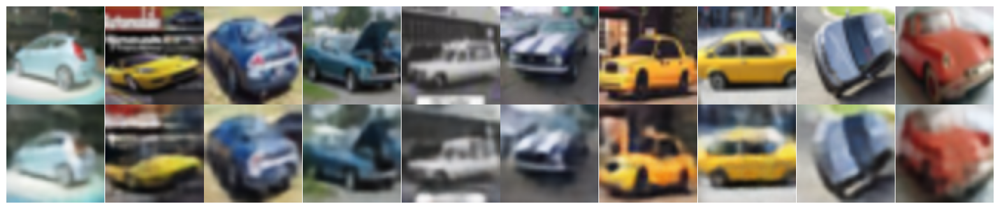

In [ ]:
# The GS-VAE model was trained by full dataset by using regular decay temperature strategy

import matplotlib.pyplot as plt
from torch.utils.data import DataLoader, Subset
from torchvision import datasets, transforms

BATCH_SIZE = 64
device = 'cuda' if torch.cuda.is_available() else 'cpu'

# Define the transformation
transform = transforms.Compose([
    transforms.Resize((64, 64)),
    transforms.ToTensor()
])


test_dataset = datasets.CIFAR10('./data', train=False, transform=transform, download=True)

# Filter out class 1 from the test dataset
class_1_indices = [i for i, (_, label) in enumerate(test_dataset) if label == 1]
class_1_dataset = Subset(test_dataset, class_1_indices)

# Create a data loader for class 1 only
class_1_loader = DataLoader(class_1_dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=4, pin_memory=True)

def plot_images(original_images, reconstructed_images, n=10):
    original_images = original_images.cpu().numpy()
    reconstructed_images = reconstructed_images.cpu().detach().numpy()
    fig, axes = plt.subplots(2, n, figsize=(20, 4))
    plt.subplots_adjust(wspace=0, hspace=0)
    for i in range(n):
        # Display original images
        ax = axes[0, i]
        ax.imshow(original_images[i].transpose(1, 2, 0))
        ax.axis('off')  # Hide axes

        # Display reconstructed images
        ax = axes[1, i]
        ax.imshow(reconstructed_images[i].transpose(1, 2, 0))
        ax.axis('off')  # Hide axes
    plt.show()


# Choose a random batch of class 1 images from the test dataset
data, _ = next(iter(class_1_loader))
data = data.to(device)

# Pass the images through the best model
recon_batch, _, _, _, _ = models[best_model_idx](data)

# Plot the original and reconstructed images
plot_images(data.cpu(), recon_batch.cpu())


MSE Loss: 0.001211221911944449


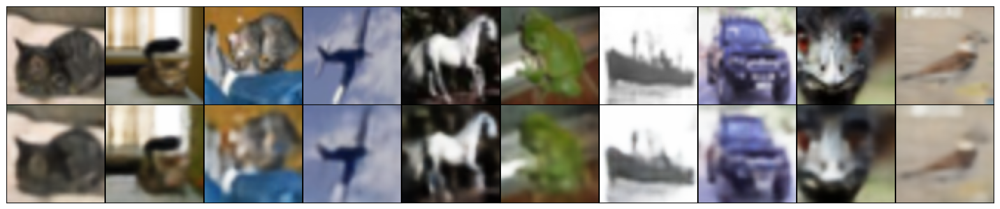

Pixel Error: 2.4366257712244987%


In [ ]:
# Test our proposed model's MSE on CIFAR-10
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt
from torchvision.utils import make_grid
import numpy as np

# Function to calculate MSE loss
def calculate_mse(original, reconstructed):
    mse_loss = F.mse_loss(reconstructed, original, reduction='mean')
    return mse_loss.item()

# Function to calculate FID score
def calculate_fid(real_features, fake_features):
    mu1, mu2 = np.mean(real_features, axis=0), np.mean(fake_features, axis=0)
    sigma1, sigma2 = np.cov(real_features, rowvar=False), np.cov(fake_features, rowvar=False)
    diff = np.sum((mu1 - mu2) ** 2.0)
    covmean = np.linalg.sqrt(sigma1.dot(sigma2))
    fid = diff + np.trace(sigma1 + sigma2 - 2.0 * covmean)
    return fid

# Function to calculate pixel error
def calculate_pixel_error(original, reconstructed):
    pixel_error = torch.mean(torch.abs(original - reconstructed)).item()
    return pixel_error * 100  # Convert to percentage

# Function to plot images without white spaces
def plot_images(original_images, reconstructed_images, n=15):
    # Convert tensors to numpy arrays
    original_images_np = original_images.cpu().numpy()
    reconstructed_images_np = reconstructed_images.cpu().detach().numpy()

    plt.figure(figsize=(20, 4))
    for i in range(n):
        # Plot original images
        ax = plt.subplot(2, n, i + 1)
        plt.imshow(np.transpose(original_images_np[i], (1, 2, 0)))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

        # Plot reconstructed images
        ax = plt.subplot(2, n, i + n + 1)
        plt.imshow(np.transpose(reconstructed_images_np[i], (1, 2, 0)))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

    plt.subplots_adjust(wspace=0, hspace=0)
    plt.show()


data, _ = next(iter(test_loader))
data = data.to(device)

# Randomly select n images
indices = torch.randperm(len(data))[:15]
selected_data = data[indices]

# Pass the images through the model
recon_batch, _, _, _, _ = models[best_model_idx](selected_data)

# Calculate MSE
mse_loss = calculate_mse(selected_data, recon_batch)
print(f'MSE Loss: {mse_loss}')

# Plot the original and reconstructed images
plot_images(selected_data.cpu(), recon_batch.cpu(), n=10)

# Calculate pixel error
pixel_error = calculate_pixel_error(selected_data, recon_batch)
print(f'Pixel Error: {pixel_error}%')


Files already downloaded and verified


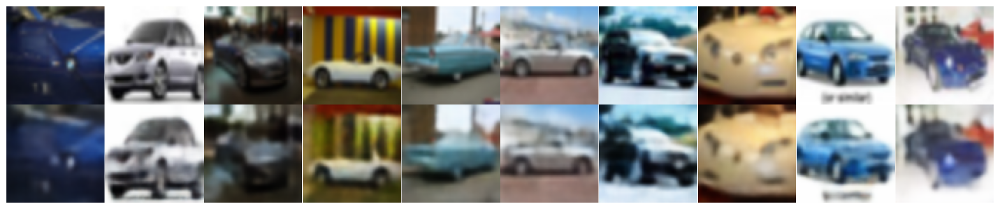

In [ ]:
# The GS-VAE model was trained by dataset without class 1 (automobile) by using regular decay temperature strategy
# To reconstruct the unseen class "automobile" (class 1)
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader, Subset
from torchvision import datasets, transforms

BATCH_SIZE = 64
device = 'cuda' if torch.cuda.is_available() else 'cpu'

# Define the transformation
transform = transforms.Compose([
    transforms.Resize((64, 64)),
    transforms.ToTensor()
])


test_dataset = datasets.CIFAR10('./data', train=False, transform=transform, download=True)

# Filter out class 1 from the test dataset
class_1_indices = [i for i, (_, label) in enumerate(test_dataset) if label == 1]
class_1_dataset = Subset(test_dataset, class_1_indices)

# Create a data loader for class 1 only
class_1_loader = DataLoader(class_1_dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=4, pin_memory=True)

def plot_images(original_images, reconstructed_images, n=10):
    original_images = original_images.cpu().numpy()
    reconstructed_images = reconstructed_images.cpu().detach().numpy()
    fig, axes = plt.subplots(2, n, figsize=(20, 4))
    plt.subplots_adjust(wspace=0, hspace=0)
    for i in range(n):
        # Display original images
        ax = axes[0, i]
        ax.imshow(original_images[i].transpose(1, 2, 0))
        ax.axis('off')  # Hide axes

        # Display reconstructed images
        ax = axes[1, i]
        ax.imshow(reconstructed_images[i].transpose(1, 2, 0))
        ax.axis('off')  # Hide axes
    plt.show()


# Choose a random batch of class 1 images from the test dataset
data, _ = next(iter(class_1_loader))
data = data.to(device)

# Pass the images through the best model
recon_batch, _, _, _, _ = models[best_model_idx](data)

# Plot the original and reconstructed images
plot_images(data.cpu(), recon_batch.cpu())


Files already downloaded and verified
Files already downloaded and verified


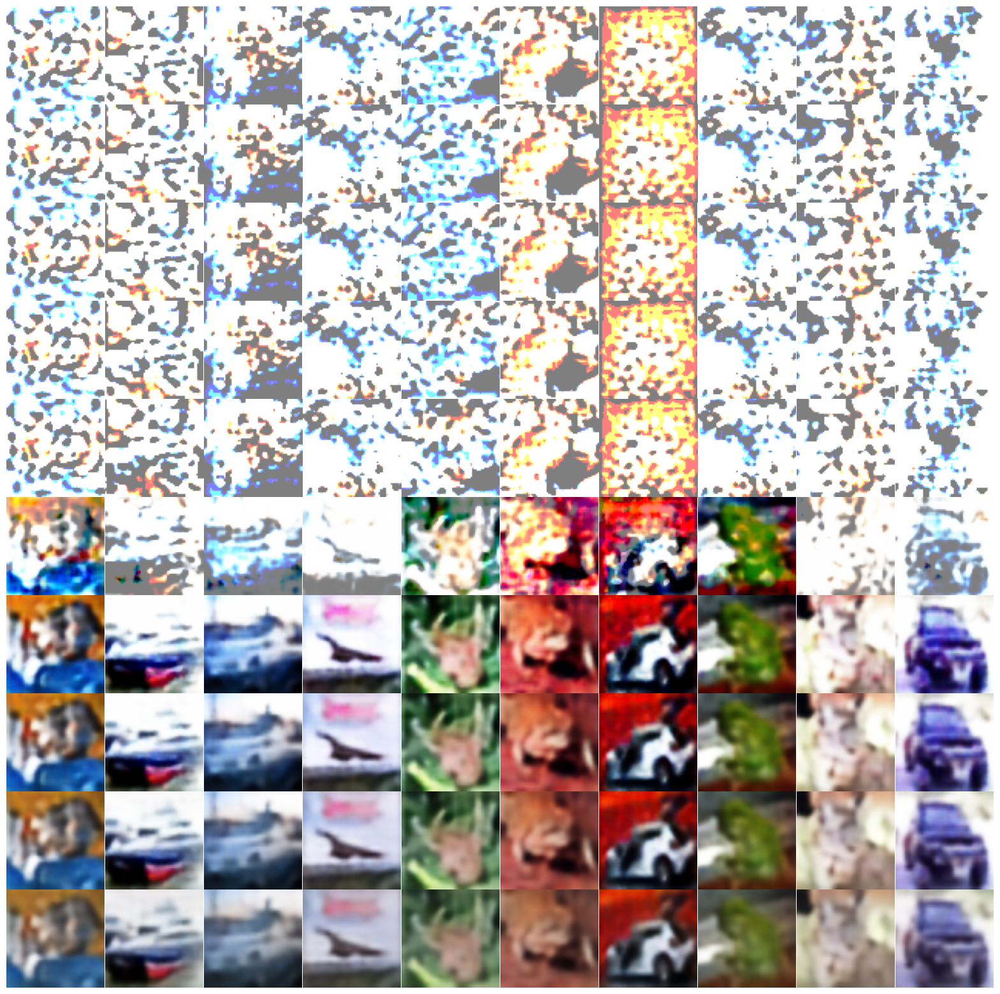

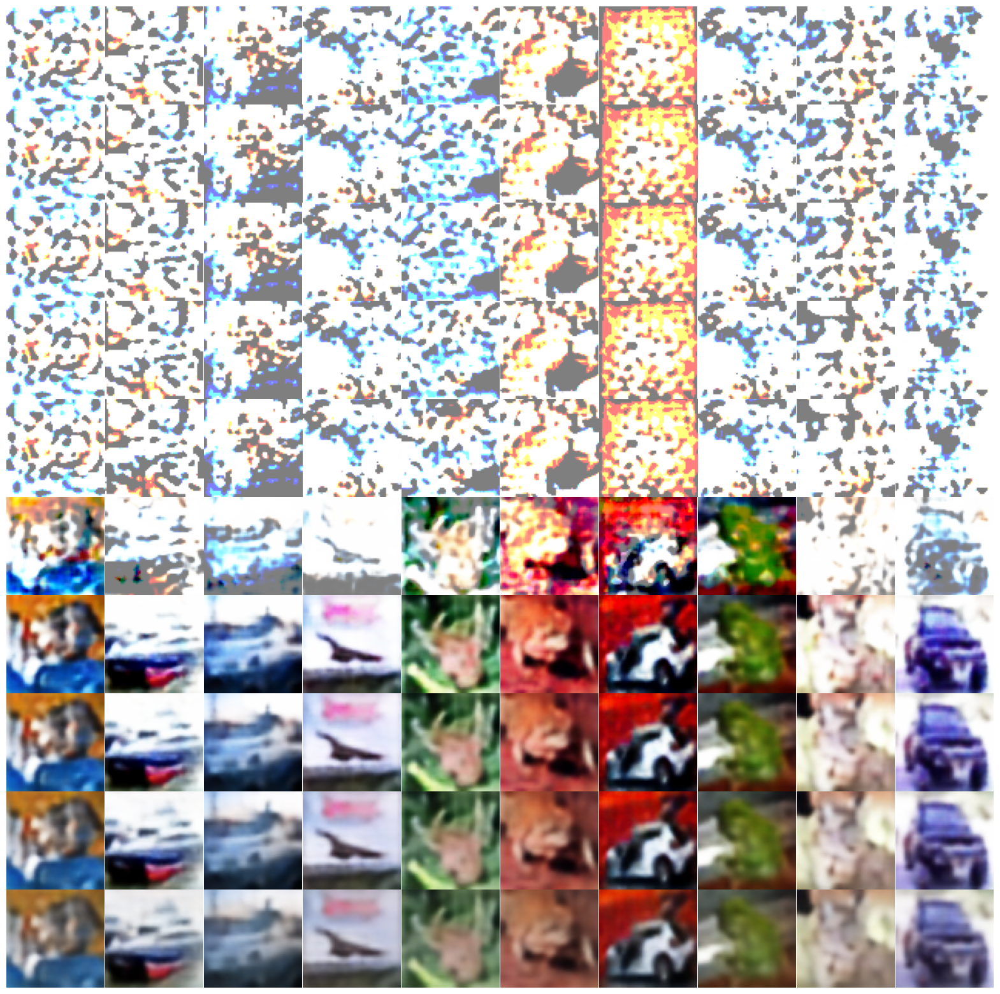

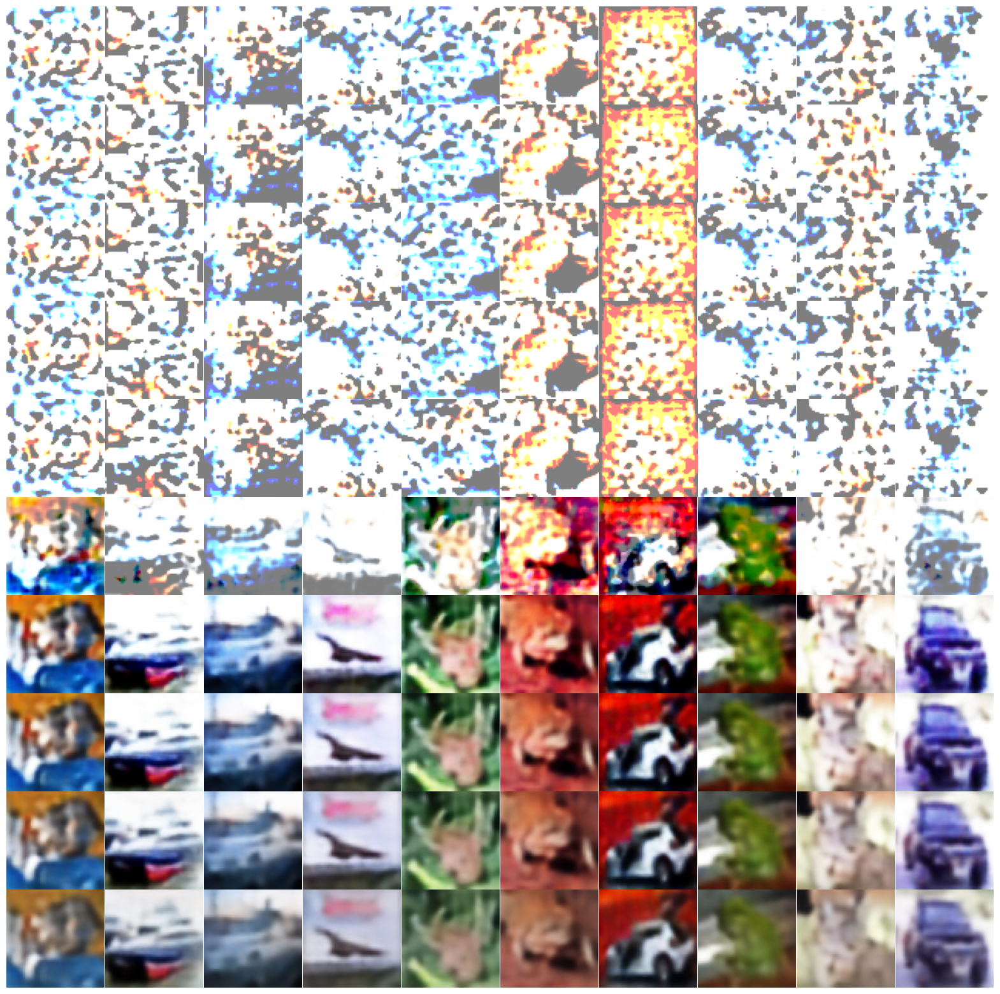

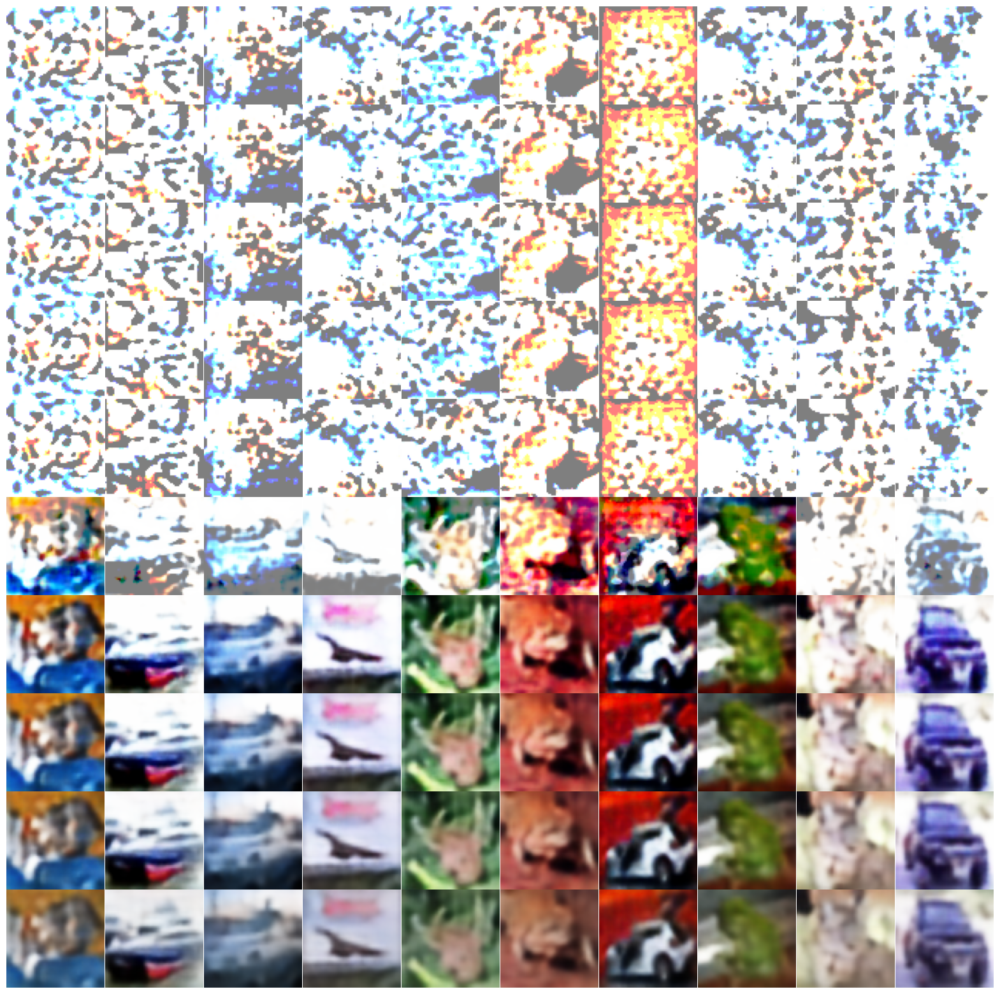

KeyboardInterrupt: 

In [ ]:
# Observe the impact of temperature on the model trained by parallel framework
# All submodels adopt the linear increasing temperature strategys with diffrent changing rates
import torch
import matplotlib.pyplot as plt
from torchvision import datasets, transforms

# Function to plot reconstructed images in one large figure
def plot_all_reconstructed_images(tau_values, test_loader, model, device, n=10):
    fig, axes = plt.subplots(len(tau_values), n, figsize=(20, 2 * len(tau_values)))
    plt.subplots_adjust(wspace=0, hspace=0)  # Remove spaces between subplots

    for row, tau in enumerate(tau_values):
        model.tau_1 = tau
        model.tau_2 = tau
        data, _ = next(iter(test_loader))
        data = data.to(device)
        recon_batch, _, _, _, _ = model(data)
        reconstructed_images = recon_batch.cpu().detach().numpy()

        for col in range(n):
            ax = axes[row, col]
            ax.imshow(np.transpose(reconstructed_images[col], (1, 2, 0)))
            ax.axis('off')  # Hide axes

    plt.show()



# Define the transform for image preprocessing
transform = transforms.Compose([
    transforms.Resize((64, 64)),
    transforms.ToTensor()
])

# Download and load the CIFAR-10 dataset
train_dataset = datasets.CIFAR10('./data', train=True, transform=transform, download=True)
test_dataset = datasets.CIFAR10('./data', train=False, transform=transform, download=True)

# Create data loaders
train_loader = DataLoader(train_dataset, shuffle=True, batch_size=BATCH_SIZE, num_workers=4, pin_memory=True)
test_loader = DataLoader(test_dataset, shuffle=False, batch_size=BATCH_SIZE, num_workers=4, pin_memory=True)


# Tau values to test
tau_values = [0.5, 0.9, 0.95, 5, 10, 100, 200, 250, 300, 384]

# Iterate over tau values, update model, and plot reconstructed images
for tau in tau_values:
    models[best_model_idx].tau_1 = tau
    models[best_model_idx].tau_2 = tau
    data, _ = next(iter(test_loader))
    data = data.to(device)
    recon_batch, _, _, _, _ = models[best_model_idx](data)
     # Only plot reconstructed images
    plot_all_reconstructed_images(tau_values, test_loader, model, device)


In [11]:
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.transforms as transforms
import torchvision.datasets as datasets
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
import copy
import numpy as np
import os
import torch.nn.functional as F
from torch.utils.data import TensorDataset
from torchvision import transforms
from torchvision.datasets import MNIST
from torch import optim

# Set the random seed and device
SEED = 1
torch.manual_seed(SEED)
cuda = torch.cuda.is_available()
device = torch.device('cuda' if cuda else 'cpu')
SAVE_PATH = r"/content/sample_data/best_model_cifar10_parallel_desktop2070_August_16.pth"
BATCH_SIZE = 128
Z_DIM = 300

# Define the transform for image preprocessing
transform = transforms.Compose([
    transforms.Resize((64, 64)),
    transforms.ToTensor()
])

# Download and load the CIFAR-10 dataset
train_dataset = datasets.CIFAR10('./data', train=True, transform=transform, download=True)
test_dataset = datasets.CIFAR10('./data', train=False, transform=transform, download=True)

# Create data loaders
train_loader = DataLoader(train_dataset, shuffle=True, batch_size=BATCH_SIZE, num_workers=4, pin_memory=True)
test_loader = DataLoader(test_dataset, shuffle=False, batch_size=BATCH_SIZE, num_workers=4, pin_memory=True)

# Define the GumbelSoftmaxVAE model
class GumbelSoftmaxVAE(nn.Module):
    def __init__(self, tau_1=1.0, tau_2=1.0):
        super().__init__()

        self.tau_1 = tau_1
        self.tau_2 = tau_2

        # Encoder
        self.conv1 = nn.Conv2d(3, 32, kernel_size=4, stride=2, padding=1)
        self.conv2 = nn.Conv2d(32, 64, kernel_size=4, stride=2, padding=1)
        self.conv3 = nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1)
        self.conv4 = nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1)

        # Two layers of latent variables
        self.fc_logits_z1 = nn.Linear(256 * 4 * 4, Z_DIM)
        self.fc_logits_z2 = nn.Linear(Z_DIM, Z_DIM)

        # Decoder for each layer
        self.fc_dec1 = nn.Linear(Z_DIM, 256 * 4 * 4)
        self.fc_dec2 = nn.Linear(Z_DIM, 128 * 8 * 8)

        self.conv_trans1_1 = nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1)
        self.conv_trans2_1 = nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1)
        self.conv_trans3_1 = nn.ConvTranspose2d(64, 32, kernel_size=4, stride=2, padding=1)
        self.conv_trans4_1 = nn.ConvTranspose2d(32, 3, kernel_size=4, stride=2, padding=1)

        self.conv_trans1_2 = nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1)
        self.conv_trans2_2 = nn.ConvTranspose2d(64, 32, kernel_size=4, stride=2, padding=1)
        self.conv_trans3_2 = nn.ConvTranspose2d(32, 3, kernel_size=4, stride=2, padding=1)

    def encode(self, x):
        x = F.relu(self.conv1(x))
        x = F.relu(self.conv2(x))
        x = F.relu(self.conv3(x))
        x = F.relu(self.conv4(x))
        x = x.view(x.size(0), -1)

        logits_z1 = self.fc_logits_z1(x)
        logits_z2 = self.fc_logits_z2(logits_z1)

        return logits_z1, logits_z2

    def reparameterize(self, logits, tau):
        gumbel_noise = torch.rand_like(logits).to(device)
        gumbel_noise = -torch.log(-torch.log(gumbel_noise + 1e-8) + 1e-8)
        z = (logits + gumbel_noise) / tau
        z = F.softmax(z, dim=-1)
        return z

    def decode1(self, z):
        z = self.fc_dec1(z)
        z = z.view(z.size(0), 256, 4, 4)  # reshape
        z = F.relu(self.conv_trans1_1(z))
        z = F.relu(self.conv_trans2_1(z))
        z = F.relu(self.conv_trans3_1(z))
        z = torch.tanh(self.conv_trans4_1(z))
        z = torch.clamp(z, 0, 1)  # Clamp the values between 0 and 1
        return z

    def decode2(self, z):
        z = self.fc_dec2(z)
        z = z.view(z.size(0), 128, 8, 8)  # reshape
        z = F.relu(self.conv_trans1_2(z))
        z = F.relu(self.conv_trans2_2(z))
        z = torch.sigmoid(self.conv_trans3_2(z))
        z = torch.clamp(z, 0, 1)  # Clamp the values between 0 and 1
        return z

    def forward(self, x):
        logits_z1, logits_z2 = self.encode(x)
        z1 = self.reparameterize(logits_z1, self.tau_1)
        z2 = self.reparameterize(logits_z2, self.tau_2)

        x_hat1 = self.decode1(z1)
        x_hat2 = self.decode2(z2)

        # Average the output of the two decoders
        x_hat = (x_hat1 + x_hat2) / 2.0

        return x_hat, logits_z1, logits_z2, z1, z2

    def gumbel_softmax_loss_function(self, recon_x, x, logits_z1, logits_z2, z1, z2):
        # Clamp the values of recon_x between 0 and 1
        recon_x = torch.clamp(recon_x, 0, 1)
        # Binary cross entropy
        xent_loss = F.binary_cross_entropy(recon_x, x, reduction='none')
        xent_loss = torch.sum(xent_loss, dim=[1, 2, 3])

        # KL divergence for each layer
        p_z1 = F.softmax(logits_z1, dim=-1)
        p_z1 = torch.clamp(p_z1, torch.finfo(p_z1.dtype).eps, 1. - torch.finfo(p_z1.dtype).eps)  # to prevent log(0)
        kl_loss_z1 = torch.sum(p_z1 * torch.log(p_z1 * Z_DIM + torch.finfo(p_z1.dtype).eps), dim=-1)

        p_z2 = F.softmax(logits_z2, dim=-1)
        p_z2 = torch.clamp(p_z2, torch.finfo(p_z2.dtype).eps, 1. - torch.finfo(p_z2.dtype).eps)  # to prevent log(0)
        kl_loss_z2 = torch.sum(p_z2 * torch.log(p_z2 * Z_DIM + torch.finfo(p_z2.dtype).eps), dim=-1)

        # Total loss is the sum of the losses for each layer
        vae_loss = torch.mean(xent_loss + kl_loss_z1 + kl_loss_z2)
        return vae_loss

# Load the saved model
best_model = GumbelSoftmaxVAE().to(device)
state_dict = torch.load(SAVE_PATH)
# Remove the 'tau_1' and 'tau_2' keys
state_dict.pop('tau_1', None)
state_dict.pop('tau_2', None)
best_model.load_state_dict(state_dict)
best_model.tau_1 = 384.61
best_model.tau_2 = 384.61
best_model.eval()



Files already downloaded and verified
Files already downloaded and verified


GumbelSoftmaxVAE(
  (conv1): Conv2d(3, 32, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (conv2): Conv2d(32, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (conv3): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (conv4): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (fc_logits_z1): Linear(in_features=4096, out_features=300, bias=True)
  (fc_logits_z2): Linear(in_features=300, out_features=300, bias=True)
  (fc_dec1): Linear(in_features=300, out_features=4096, bias=True)
  (fc_dec2): Linear(in_features=300, out_features=8192, bias=True)
  (conv_trans1_1): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (conv_trans2_1): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (conv_trans3_1): ConvTranspose2d(64, 32, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (conv_trans4_1): ConvTranspose2d(32, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (conv_trans1_2)

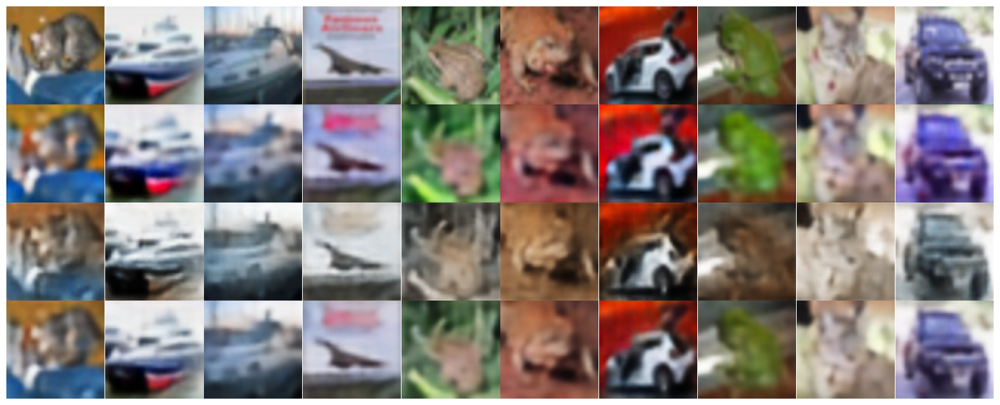

In [4]:
# The GS-VAE model was trained by using parallel temperature adjustment framework
# Test each latent layer's contribution

def plot_images_from_layers_and_reconstruction(data, model):
    with torch.no_grad():  # Ensure we're in no_grad mode when doing inference
        logits_z1, logits_z2 = model.encode(data)
        z1 = model.reparameterize(logits_z1, model.tau_1)
        z2 = model.reparameterize(logits_z2, model.tau_2)
        recon_images_layer1 = model.decode1(z1)
        recon_images_layer2 = model.decode2(z2)
        # Combine the layers to create the final reconstruction
        final_reconstruction = (recon_images_layer1 + recon_images_layer2) / 2.0

        # Plot images
        fig, axes = plt.subplots(4, 10, figsize=(20, 8))
        plt.subplots_adjust(wspace=0, hspace=0)  # Remove whitespace

        for i in range(10):
            # Original images
            axes[0, i].imshow(data[i].cpu().permute(1, 2, 0))
            axes[0, i].axis('off')
            # Reconstructed images from layer 1
            axes[1, i].imshow(recon_images_layer1[i].cpu().permute(1, 2, 0))
            axes[1, i].axis('off')
            # Reconstructed images from layer 2
            axes[2, i].imshow(recon_images_layer2[i].cpu().permute(1, 2, 0))
            axes[2, i].axis('off')
            # Final reconstructed images
            axes[3, i].imshow(final_reconstruction[i].cpu().permute(1, 2, 0))
            axes[3, i].axis('off')

        plt.show()


# Choose a random batch of images from the test dataset
data, _ = next(iter(test_loader))
data = data.to(device)
plot_images_from_layers_and_reconstruction(data, best_model)

Files already downloaded and verified
Best Anomaly Detection Accuracy: 0.98 at Threshold: 0.01


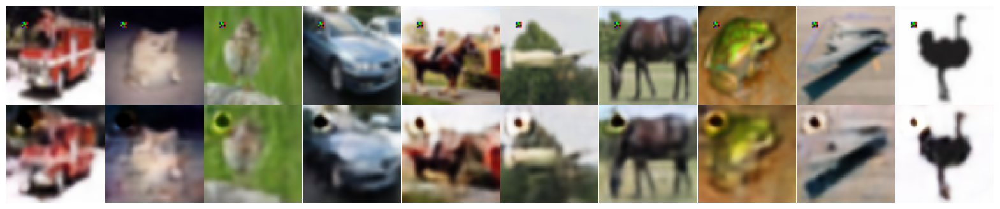

In [6]:
# The GS-VAE model was trained by full dataset by using parallel temperature adjustment framework
# Test the model for detecting the small-scale patch
import torch
import numpy as np
import matplotlib.pyplot as plt
import torch.nn.functional as F
from torchvision import datasets, transforms
from torch.utils.data import DataLoader

BATCH_SIZE = 64
device = 'cuda' if torch.cuda.is_available() else 'cpu'

# Define the transformation and download CIFAR-10 test dataset
transform = transforms.Compose([transforms.Resize((64, 64)), transforms.ToTensor()])
test_dataset = datasets.CIFAR10('./data', train=False, transform=transform, download=True)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=4, pin_memory=True)

# Function to add Gaussian noise (do not use in this cell)
def add_gaussian_noise(images, mean=0.0, std=0.0):
    return images + torch.randn_like(images) * std + mean

# Function to add an adversarial patch
def add_adversarial_patch(images, patch_size=(4, 4), start_x=10, start_y=10):
    patched_images = images.clone()
    patch = torch.randn((3, patch_size[0], patch_size[1]))  # Change the order of dimensions
    for img in patched_images:
        img[:, start_y:start_y+patch_size[1], start_x:start_x+patch_size[0]] = patch
    return patched_images

import matplotlib.pyplot as plt
import numpy as np

def plot_images(original_images, reconstructed_images, n=10):
    fig, axes = plt.subplots(2, n, figsize=(20, 4))
    plt.subplots_adjust(wspace=0, hspace=0)

    for i in range(n):
        # Display original images
        ax = axes[0, i]
        original_img = np.transpose(original_images[i].numpy(), (1, 2, 0))
        ax.imshow(original_img, cmap='gray')
        ax.axis('off')

        # Display reconstructed images
        ax = axes[1, i]
        recon_img = np.transpose(reconstructed_images[i].detach().numpy(), (1, 2, 0))  # Use detach() here
        ax.imshow(recon_img, cmap='gray')
        ax.axis('off')

    plt.show()

# Choose a random batch of images from the test dataset
data, _ = next(iter(test_loader))
data = data.to(device)

# Add Gaussian noise and adversarial patch
noisy_data = add_gaussian_noise(data)
patched_data = add_adversarial_patch(noisy_data)

# Pass the images through the model
recon_batch = best_model(patched_data)[0]

# Function to calculate reconstruction error
def calculate_reconstruction_error(data, recon_data):
    return F.mse_loss(recon_data, data, reduction='none').mean([1, 2, 3])

# Calculate reconstruction errors
reconstruction_errors = calculate_reconstruction_error(patched_data, recon_batch)
reconstruction_errors = reconstruction_errors.detach().cpu().numpy()

# Find the best threshold for anomaly detection
best_accuracy = 0.0
best_threshold = 0.0
for percentile in range(0, 100):
    threshold = np.percentile(reconstruction_errors, percentile)
    predicted_anomalies = reconstruction_errors > threshold
    accuracy = np.mean(predicted_anomalies)
    if accuracy > best_accuracy:
        best_accuracy = accuracy
        best_threshold = threshold

# Display results
print(f"Best Anomaly Detection Accuracy: {best_accuracy:.2f} at Threshold: {best_threshold:.2f}")

# Plot the original (patched) and reconstructed images
original_images = patched_data.cpu()
reconstructed_images = recon_batch.cpu()

plot_images(original_images, reconstructed_images, n=10)



Files already downloaded and verified
Files already downloaded and verified
Best Anomaly Detection Accuracy: 1.00 at Threshold: 0.00
Image 1: Patched: No, Predicted: No
Image 2: Patched: Yes, Predicted: Yes
Image 3: Patched: No, Predicted: No
Image 4: Patched: Yes, Predicted: Yes
Image 5: Patched: No, Predicted: No
Image 6: Patched: Yes, Predicted: Yes
Image 7: Patched: No, Predicted: No
Image 8: Patched: No, Predicted: No
Image 9: Patched: No, Predicted: No
Image 10: Patched: Yes, Predicted: Yes
Image 11: Patched: No, Predicted: No
Image 12: Patched: Yes, Predicted: Yes
Image 13: Patched: Yes, Predicted: Yes
Image 14: Patched: Yes, Predicted: Yes
Image 15: Patched: Yes, Predicted: Yes
Image 16: Patched: No, Predicted: No
Image 17: Patched: Yes, Predicted: Yes
Image 18: Patched: Yes, Predicted: Yes
Image 19: Patched: No, Predicted: No
Image 20: Patched: Yes, Predicted: Yes
Image 21: Patched: No, Predicted: No
Image 22: Patched: Yes, Predicted: Yes
Image 23: Patched: No, Predicted: No
I

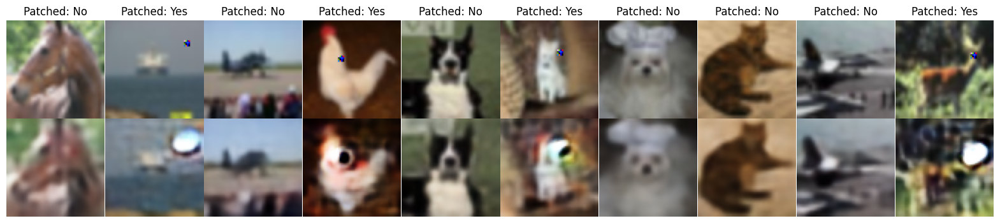

Best Anomaly Detection Accuracy: 1.00 at Threshold: 0.00


In [7]:
# The GS-VAE model was trained by full dataset by using parallel temperature adjustment framework
# Test the model for detecting the small-scale patch
import torch
import numpy as np
import matplotlib.pyplot as plt
import torch.nn.functional as F
from torchvision import datasets, transforms
from torch.utils.data import DataLoader

BATCH_SIZE = 50  # Update batch size to 50
device = 'cuda' if torch.cuda.is_available() else 'cpu'

transform = transforms.Compose([transforms.Resize((64, 64)), transforms.ToTensor()])
test_dataset = datasets.CIFAR10('./data', train=False, transform=transform, download=True)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=4, pin_memory=True)

transform = transforms.Compose([transforms.Resize((64, 64)), transforms.ToTensor()])
test_dataset = datasets.CIFAR10('./data', train=False, transform=transform, download=True)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=4, pin_memory=True)

def add_adversarial_patch(images, patch_size=(4, 4), probability=0.6):
    patched_images = images.clone()
    patch = torch.randn((3, patch_size[0], patch_size[1]))
    is_patched = np.zeros(len(images), dtype=bool)
    for idx, img in enumerate(patched_images):
        if np.random.rand() < probability:
            start_x = np.random.randint(0, img.shape[2] - patch_size[1])
            start_y = np.random.randint(0, img.shape[1] - patch_size[0])
            img[:, start_y:start_y+patch_size[1], start_x:start_x+patch_size[0]] = patch
            is_patched[idx] = True
    return patched_images, is_patched

data, _ = next(iter(test_loader))
data = data.to(device)

patched_data, is_patched = add_adversarial_patch(data)

recon_batch, _, _, _, _ = best_model(patched_data)

def calculate_reconstruction_error(data, recon_data):
    return F.mse_loss(recon_data, data, reduction='none').mean([1, 2, 3])

# Calculate reconstruction errors
reconstruction_errors = calculate_reconstruction_error(patched_data, recon_batch)
reconstruction_errors = reconstruction_errors.detach().cpu().numpy()

# Determine the best threshold for anomaly detection
best_accuracy = 0.0
best_threshold = 0.0
for percentile in range(0, 100):
    threshold = np.percentile(reconstruction_errors, percentile)
    predicted_anomalies = reconstruction_errors > threshold
    accuracy = (predicted_anomalies == is_patched).mean()
    if accuracy > best_accuracy:
        best_accuracy = accuracy
        best_threshold = threshold

# Display results
print(f"Best Anomaly Detection Accuracy: {best_accuracy:.2f} at Threshold: {best_threshold:.2f}")

# Plot the original and reconstructed images
def plot_images_with_labels(original_images, reconstructed_images, labels, n=10):
    fig, axes = plt.subplots(2, n, figsize=(20, 4))
    plt.subplots_adjust(wspace=0, hspace=0)

    for i in range(n):
        # Display original images with labels
        ax = axes[0, i]
        original_img = original_images[i].cpu().numpy()  # Move tensor to CPU
        ax.imshow(np.transpose(original_img, (1, 2, 0)))
        ax.axis('off')
        label_text = 'Yes' if labels[i] else 'No'
        ax.set_title(f"Patched: {label_text}")

        # Display reconstructed images
        ax = axes[1, i]
        recon_img = reconstructed_images[i].cpu().detach().numpy()  # Move tensor to CPU
        ax.imshow(np.transpose(recon_img, (1, 2, 0)))
        ax.axis('off')

    plt.show()

# Print whether the image was patched and the model's prediction
for i in range(50):
    actual = 'Yes' if is_patched[i] else 'No'
    predicted = 'Yes' if reconstruction_errors[i] > best_threshold else 'No'
    print(f"Image {i+1}: Patched: {actual}, Predicted: {predicted}")

# Plot images and labels for the first 10 instances
plot_images_with_labels(patched_data[:10], recon_batch[:10], is_patched[:10], n=10)
# Display results
print(f"Best Anomaly Detection Accuracy: {best_accuracy:.2f} at Threshold: {best_threshold:.2f}")

Files already downloaded and verified


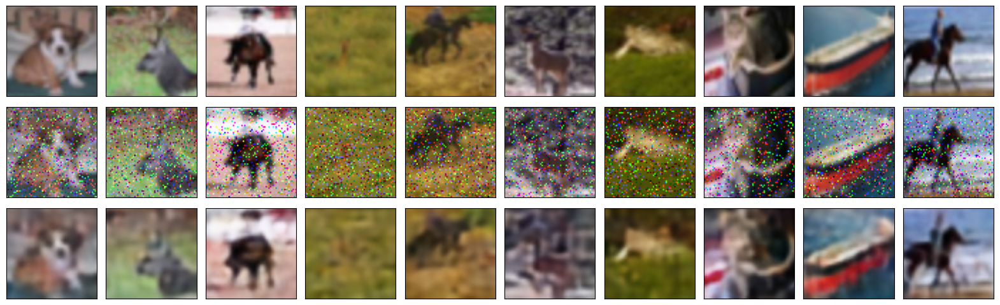

In [14]:
# Test the reconstruction of GS-VAE model was trained by the full dataset and using parallel linear increasing temperature adjustment framework (using different changing rate with model 1)
# The original images are attacked by high-intensity s&p noise
from skimage.util import random_noise
import torch
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader
from torchvision import datasets, transforms


def plot_images(original_images, noisy_images, reconstructed_noisy_images, n=10):
    plt.figure(figsize=(n * 2, 6))
    for i in range(n):
        ax = plt.subplot(3, n, i + 1)
        plt.imshow(original_images[i].transpose(1, 2, 0))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

        ax = plt.subplot(3, n, i + 1 + n)
        plt.imshow(noisy_images[i].transpose(1, 2, 0))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

        ax = plt.subplot(3, n, i + 1 + 2 * n)
        plt.imshow(reconstructed_noisy_images[i].transpose(1, 2, 0))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

    plt.subplots_adjust(wspace=0.1, hspace=0.1)
    plt.show()


transform = transforms.Compose([
    transforms.Resize((64, 64)),
    transforms.ToTensor()
])
test_dataset = datasets.CIFAR10('./data', train=False, transform=transform, download=True)
test_loader = DataLoader(test_dataset, shuffle=True, batch_size=10, num_workers=4, pin_memory=True)


data, _ = next(iter(test_loader))
data = data.to(device)

original_images = data.cpu().numpy()

noisy_images = random_noise(original_images, mode="s&p", amount=0.1)

noisy_data_tensor = torch.tensor(noisy_images, dtype=torch.float32).to(device)
with torch.no_grad():
    recon_noisy_batch, _, _, _, _ = best_model(noisy_data_tensor)  # Extract only the reconstructed images

# Plot the original, noisy, and reconstructed images
plot_images(original_images, noisy_images, recon_noisy_batch.cpu().numpy(), n=10)



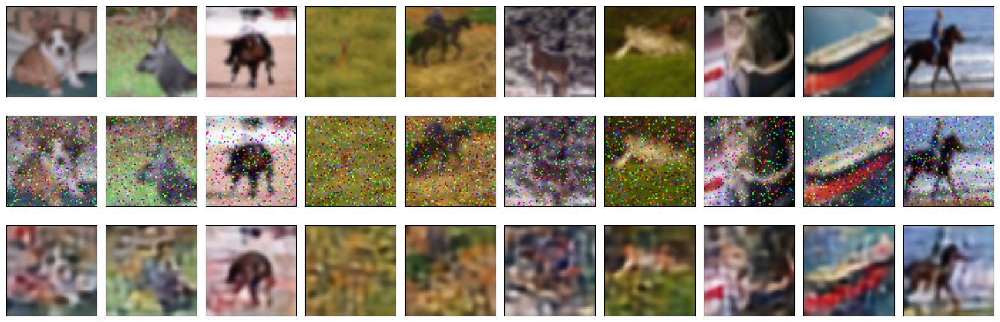

In [21]:
# Test the reconstruction of GS-VAE model was trained by the dataset without class automobile by using parallel linear increasing temperature adjustment framework (using different changing rate with model 1)
# The original images are attacked by high-intensity Gaussian noise
import torch
import matplotlib.pyplot as plt
import numpy as np

def add_gaussian_noise(images, mean=0.0, std=0.4):
    noise = np.random.normal(mean, std, images.shape)
    noisy_images = images + noise
    return np.clip(noisy_images, 0, 1)

def plot_images(original_images, noisy_images, reconstructed_noisy_images, n=10):
    plt.figure(figsize=(n * 2, 6.5))
    for i in range(n):

        ax = plt.subplot(3, n, i + 1)
        plt.imshow(original_images[i].transpose(1, 2, 0))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)


        ax = plt.subplot(3, n, i + 1 + n)
        plt.imshow(noisy_images[i].transpose(1, 2, 0))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)


        ax = plt.subplot(3, n, i + 1 + 2 * n)
        plt.imshow(reconstructed_noisy_images[i].transpose(1, 2, 0))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

    plt.subplots_adjust(wspace=0.1, hspace=0.1)
    plt.show()


noisy_data = add_gaussian_noise(data.cpu().numpy())

noisy_data_tensor = torch.tensor(noisy_data).float().to(device)

with torch.no_grad():
    recon_noisy_batch, _, _, _, _ = best_model(noisy_data_tensor)  # Extract only the reconstructed images

# Plot the original, noisy, and reconstructed images
plot_images(original_images, noisy_images, recon_noisy_batch.cpu().numpy(), n=10)


In [23]:
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import datasets, transforms
from torch.utils.data import DataLoader

transform = transforms.Compose([
    transforms.Resize((64, 64)),
    transforms.RandomHorizontalFlip(),
    transforms.RandomCrop(64, padding=4),
    transforms.ToTensor(),
])

train_dataset = datasets.CIFAR10('./data', train=True, transform=transform, download=True)
test_dataset = datasets.CIFAR10('./data', train=False, transform=transform, download=True)

BATCH_SIZE = 128
train_loader = DataLoader(train_dataset, shuffle=True, batch_size=BATCH_SIZE, num_workers=4, pin_memory=True)
test_loader = DataLoader(test_dataset, shuffle=False, batch_size=BATCH_SIZE, num_workers=4, pin_memory=True)

# Define a deeper CNN model
class CustomCNN(nn.Module):
    def __init__(self, num_classes=10):
        super(CustomCNN, self).__init__()
        self.conv_layers = nn.Sequential(
            nn.Conv2d(3, 64, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.BatchNorm2d(64),
            nn.Conv2d(64, 64, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.BatchNorm2d(64),
            nn.MaxPool2d(kernel_size=2, stride=2),

            nn.Conv2d(64, 128, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.BatchNorm2d(128),
            nn.Conv2d(128, 128, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.BatchNorm2d(128),
            nn.MaxPool2d(kernel_size=2, stride=2),

            nn.Conv2d(128, 256, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.BatchNorm2d(256),
            nn.Conv2d(256, 256, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.BatchNorm2d(256),
            nn.MaxPool2d(kernel_size=2, stride=2),

            nn.Conv2d(256, 512, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.BatchNorm2d(512),
            nn.Conv2d(512, 512, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.BatchNorm2d(512),
            nn.MaxPool2d(kernel_size=2, stride=2),
        )
        self.fc_layers = nn.Sequential(
            nn.Dropout(0.5),
            nn.Linear(512 * 4 * 4, 512),
            nn.ReLU(),
            nn.BatchNorm1d(512),
            nn.Dropout(0.5),
            nn.Linear(512, num_classes)
        )

    def forward(self, x):
        x = self.conv_layers(x)
        x = x.view(x.size(0), -1)
        x = self.fc_layers(x)
        return x


num_classes = 10

# Create an instance of the model
cnn_model = CustomCNN(num_classes)

# Define loss function and optimizer
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(cnn_model.parameters(), lr=0.001)

# Learning rate scheduler
scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='max', factor=0.1, patience=5, verbose=True)

# Training loop
num_epochs = 100
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
cnn_model.to(device)

best_accuracy = 0.0
best_model_state = None

def evaluate_model(model, test_loader, device):
    model.eval()
    correct = 0
    total = 0
    with torch.no_grad():
        for inputs, labels in test_loader:
            inputs, labels = inputs.to(device), labels.to(device)
            outputs = model(inputs)
            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()
    return 100 * correct / total


for epoch in range(num_epochs):
    cnn_model.train()
    running_loss = 0.0
    for inputs, labels in train_loader:
        inputs, labels = inputs.to(device), labels.to(device)

        optimizer.zero_grad()
        outputs = cnn_model(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        running_loss += loss.item()

    # Evaluate the model
    accuracy = evaluate_model(cnn_model, test_loader, device)
    print(f"Epoch {epoch + 1}/{num_epochs}, Loss: {running_loss / len(train_loader)}, Accuracy: {accuracy}%")

    # Step the scheduler based on validation accuracy
    scheduler.step(accuracy)

    # Save the best model
    if accuracy > best_accuracy:
        best_accuracy = accuracy
        best_model_state = cnn_model.state_dict()

# Save the best model outside the training loop
if best_model_state is not None:
    torch.save(best_model_state, 'best_trainedCifarCNN_model.pth')
    print("Best model saved with accuracy:", best_accuracy)


Files already downloaded and verified
Files already downloaded and verified


/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


Epoch 1/100, Loss: 1.3799317948653569, Accuracy: 64.14%
Epoch 2/100, Loss: 0.8534043699579166, Accuracy: 75.39%
Epoch 3/100, Loss: 0.6504133342172179, Accuracy: 76.44%
Epoch 4/100, Loss: 0.540174526555459, Accuracy: 81.65%
Epoch 5/100, Loss: 0.46476261763621474, Accuracy: 82.92%
Epoch 6/100, Loss: 0.39875989108134413, Accuracy: 85.78%
Epoch 7/100, Loss: 0.3605684399452356, Accuracy: 85.59%
Epoch 8/100, Loss: 0.3165283678742626, Accuracy: 86.75%
Epoch 9/100, Loss: 0.2858388612566092, Accuracy: 87.1%
Epoch 10/100, Loss: 0.26084116476652264, Accuracy: 87.07%
Epoch 11/100, Loss: 0.2333178682552884, Accuracy: 87.76%
Epoch 12/100, Loss: 0.21687314758444076, Accuracy: 88.7%
Epoch 13/100, Loss: 0.1958405730288352, Accuracy: 88.97%
Epoch 14/100, Loss: 0.18195093060126694, Accuracy: 88.42%
Epoch 15/100, Loss: 0.1711633337466308, Accuracy: 89.61%
Epoch 16/100, Loss: 0.1573060626816719, Accuracy: 89.96%
Epoch 17/100, Loss: 0.14518138120317703, Accuracy: 89.5%
Epoch 18/100, Loss: 0.1413410439934876

In [55]:
# Load the saved CNN model weights
cnn_model = CustomCNN(num_classes).to(device)  # Recreate the model instance
cnn_model.load_state_dict(torch.load('/content/best_trainedCifarCNN_model.pth'))
cnn_model.eval()  # Set the model to evaluation mode

correct = 0
total = 0
with torch.no_grad():
    for inputs, labels in test_loader:
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = cnn_model(inputs)
        _, predicted = torch.max(outputs, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

accuracy = 100 * correct / total
print(f"Test Accuracy: {accuracy:.2f}%")


Test Accuracy: 92.39%


In [35]:
# Test the GS-VAE model was trained by full dataset by using parallel temperature adjustment framework

import torch
from torchvision import datasets, transforms
from torch.utils.data import DataLoader, TensorDataset, Subset
import numpy as np
import torch.nn.functional as F


BATCH_SIZE = 64
device = 'cuda' if torch.cuda.is_available() else 'cpu'

# Define the transformation
transform = transforms.Compose([
    transforms.Resize((64, 64)),
    transforms.ToTensor()
])

# Download and load the CIFAR-10 test dataset
test_dataset = datasets.CIFAR10('./data', train=False, transform=transform, download=True)
non_class_1_indices = [i for i, (_, label) in enumerate(test_dataset) if label != 1]
non_class_1_dataset = Subset(test_dataset, non_class_1_indices)
non_class_1_loader = DataLoader(non_class_1_dataset, batch_size=BATCH_SIZE, shuffle=True)

best_model.to(device).eval()


def create_recon_loader(recon_batch, original_labels):
    recon_images = recon_batch.cpu()
    recon_dataset = TensorDataset(recon_images, original_labels)
    return DataLoader(recon_dataset, batch_size=BATCH_SIZE, shuffle=False)

def calculate_accuracy(model, loader):
    correct = 0
    total = 0
    with torch.no_grad():
        for images, labels in loader:
            images, labels = images.to(device), labels.to(device)
            outputs = model(images)
            _, predicted = torch.max(outputs, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()
    return 100 * correct / total

# Function for the PGD attack
def pgd_attack(model, images, labels, eps, alpha, iters):
    images = images.clone().detach().to(device).requires_grad_(True)
    labels = labels.clone().detach().to(device)
    original_images = images.clone().detach()

    for _ in range(iters):
        outputs = model(images)
        loss = F.cross_entropy(outputs, labels)
        model.zero_grad()
        loss.backward()
        adv_images = images + alpha*images.grad.sign()
        eta = torch.clamp(adv_images - original_images, min=-eps, max=eps)
        images = torch.clamp(original_images + eta, min=0, max=1).detach_()
        images.requires_grad_(True)

    return images


def main():
    # Get a batch of data
    data, original_labels = next(iter(non_class_1_loader))
    data = data.to(device)
    original_labels = original_labels.to(device)

    # Perform PGD attack
    eps = 0.5 # intensity is 0.5
    alpha = 0.01
    iters = 20
    attacked_data = pgd_attack(cnn_model, data, original_labels, eps, alpha, iters)

    # Process images through each reconstruction model
    with torch.no_grad():
        recon_batch_model = best_model(attacked_data)[0]


    # Create data loaders for the reconstructed images
    recon_loader_model = create_recon_loader(recon_batch_model, original_labels)


    # Calculate accuracies
    accuracy_model = calculate_accuracy(cnn_model, recon_loader_model)


    # Print accuracies
    print(f'Accuracy for reconstructed images by model: {accuracy_model:.2f}%')

if __name__ == '__main__':
    main()


Files already downloaded and verified
Accuracy for reconstructed images by model: 71.88%


In [54]:
# Test the GS-VAE model was trained by full dataset by using parallel temperature adjustment framework

import torch
from torchvision import datasets, transforms
from torch.utils.data import DataLoader, TensorDataset, Subset
import numpy as np
import torch.nn.functional as F


BATCH_SIZE = 64
device = 'cuda' if torch.cuda.is_available() else 'cpu'

# Define the transformation
transform = transforms.Compose([
    transforms.Resize((64, 64)),
    transforms.ToTensor()
])

# Download and load the CIFAR-10 test dataset
test_dataset = datasets.CIFAR10('./data', train=False, transform=transform, download=True)
non_class_1_indices = [i for i, (_, label) in enumerate(test_dataset) if label != 1]
non_class_1_dataset = Subset(test_dataset, non_class_1_indices)
non_class_1_loader = DataLoader(non_class_1_dataset, batch_size=BATCH_SIZE, shuffle=True)

best_model.to(device).eval()


def create_recon_loader(recon_batch, original_labels):
    recon_images = recon_batch.cpu()
    recon_dataset = TensorDataset(recon_images, original_labels)
    return DataLoader(recon_dataset, batch_size=BATCH_SIZE, shuffle=False)

def calculate_accuracy(model, loader):
    correct = 0
    total = 0
    with torch.no_grad():
        for images, labels in loader:
            images, labels = images.to(device), labels.to(device)
            outputs = model(images)
            _, predicted = torch.max(outputs, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()
    return 100 * correct / total

# Function for the PGD attack
def pgd_attack(model, images, labels, eps, alpha, iters):
    images = images.clone().detach().to(device).requires_grad_(True)
    labels = labels.clone().detach().to(device)
    original_images = images.clone().detach()

    for _ in range(iters):
        outputs = model(images)
        loss = F.cross_entropy(outputs, labels)
        model.zero_grad()
        loss.backward()
        adv_images = images + alpha*images.grad.sign()
        eta = torch.clamp(adv_images - original_images, min=-eps, max=eps)
        images = torch.clamp(original_images + eta, min=0, max=1).detach_()
        images.requires_grad_(True)

    return images


def main():
    # Get a batch of data
    data, original_labels = next(iter(non_class_1_loader))
    data = data.to(device)
    original_labels = original_labels.to(device)

    # Perform PGD attack
    eps = 0.1 # intensity is 0.3
    alpha = 0.01
    iters = 10
    attacked_data = pgd_attack(cnn_model, data, original_labels, eps, alpha, iters)

    # Process images through each reconstruction model
    with torch.no_grad():
        recon_batch_model = best_model(attacked_data)[0]


    # Create data loaders for the reconstructed images
    recon_loader_model = create_recon_loader(recon_batch_model, original_labels)


    # Calculate accuracies
    accuracy_model = calculate_accuracy(cnn_model, recon_loader_model)


    # Print accuracies
    print(f'Accuracy for reconstructed images by model: {accuracy_model:.2f}%')

if __name__ == '__main__':
    main()


Files already downloaded and verified
Accuracy for reconstructed images by model: 64.06%


In [62]:
# Test the GS-VAE model was trained by full dataset by using parallel temperature adjustment framework

import torch
from torchvision import datasets, transforms
from torch.utils.data import DataLoader, TensorDataset, Subset
import numpy as np
import torch.nn.functional as F


BATCH_SIZE = 64
device = 'cuda' if torch.cuda.is_available() else 'cpu'

# Define the transformation
transform = transforms.Compose([
    transforms.Resize((64, 64)),
    transforms.ToTensor()
])

# Download and load the CIFAR-10 test dataset
test_dataset = datasets.CIFAR10('./data', train=False, transform=transform, download=True)
non_class_1_indices = [i for i, (_, label) in enumerate(test_dataset) if label != 1]
non_class_1_dataset = Subset(test_dataset, non_class_1_indices)
non_class_1_loader = DataLoader(non_class_1_dataset, batch_size=BATCH_SIZE, shuffle=True)

best_model.to(device).eval()


def create_recon_loader(recon_batch, original_labels):
    recon_images = recon_batch.cpu()
    recon_dataset = TensorDataset(recon_images, original_labels)
    return DataLoader(recon_dataset, batch_size=BATCH_SIZE, shuffle=False)

def calculate_accuracy(model, loader):
    correct = 0
    total = 0
    with torch.no_grad():
        for images, labels in loader:
            images, labels = images.to(device), labels.to(device)
            outputs = model(images)
            _, predicted = torch.max(outputs, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()
    return 100 * correct / total

# Function for the PGD attack
def pgd_attack(model, images, labels, eps, alpha, iters):
    images = images.clone().detach().to(device).requires_grad_(True)
    labels = labels.clone().detach().to(device)
    original_images = images.clone().detach()

    for _ in range(iters):
        outputs = model(images)
        loss = F.cross_entropy(outputs, labels)
        model.zero_grad()
        loss.backward()
        adv_images = images + alpha*images.grad.sign()
        eta = torch.clamp(adv_images - original_images, min=-eps, max=eps)
        images = torch.clamp(original_images + eta, min=0, max=1).detach_()
        images.requires_grad_(True)

    return images


def main():
    # Get a batch of data
    data, original_labels = next(iter(non_class_1_loader))
    data = data.to(device)
    original_labels = original_labels.to(device)

    # Perform PGD attack
    eps = 0.5 # intensity is 0.3
    alpha = 0.01
    iters = 10
    attacked_data = pgd_attack(cnn_model, data, original_labels, eps, alpha, iters)

    # Process images through each reconstruction model
    with torch.no_grad():
        recon_batch_model = best_model(attacked_data)[0]


    # Create data loaders for the reconstructed images
    recon_loader_model = create_recon_loader(recon_batch_model, original_labels)


    # Calculate accuracies
    accuracy_model = calculate_accuracy(cnn_model, recon_loader_model)


    # Print accuracies
    print(f'Accuracy for reconstructed images by model: {accuracy_model:.2f}%')

if __name__ == '__main__':
    main()


Files already downloaded and verified
Accuracy for reconstructed images by model: 60.94%


Files already downloaded and verified


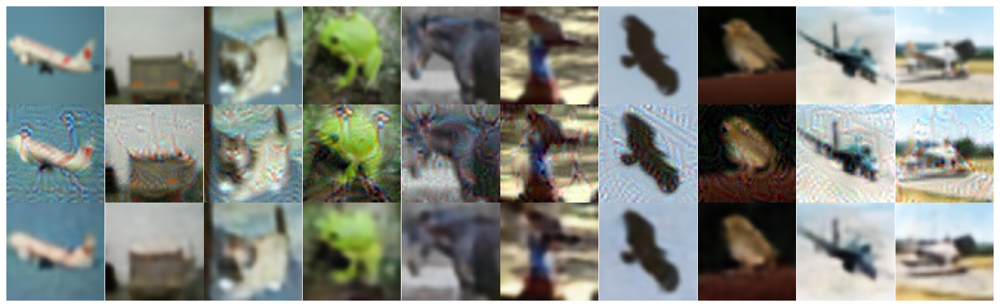

In [49]:
import matplotlib.pyplot as plt
import numpy as np

# Define a function to plot images for comparison
def plot_comparison(original_images, attacked_images, recon_images_best_model, n=15):
    fig, axes = plt.subplots(3, n, figsize=(20, 6))
    plt.subplots_adjust(wspace=0, hspace=0)  # Remove spaces between subplots
    for i in range(n):
        # Display original images
        axes[0, i].imshow(np.transpose(original_images[i], (1, 2, 0)))
        axes[0, i].axis('off')  # Hide axes

        # Display attacked images
        axes[1, i].imshow(np.transpose(attacked_images[i], (1, 2, 0)))
        axes[1, i].axis('off')  # Hide axes

        # Display reconstructed images from the best model
        axes[2, i].imshow(np.transpose(recon_images_best_model[i], (1, 2, 0)))
        axes[2, i].axis('off')  # Hide axes
    plt.show()

# Download and load the CIFAR-10 test dataset
test_dataset = datasets.CIFAR10('./data', train=False, transform=transform, download=True)
non_class_1_indices = [i for i, (_, label) in enumerate(test_dataset) if label != 1]
non_class_1_dataset = DataLoader(Subset(test_dataset, non_class_1_indices), batch_size=BATCH_SIZE, shuffle=True)

# Perform the attack and reconstruction
data, labels = next(iter(non_class_1_dataset))
data = data.to(device)
labels = labels.to(device)

eps = 0.5 # intensity is 0.5
alpha = 0.01
iters = 20


# Apply PGD attack to the original images
attacked_data = pgd_attack(cnn_model, data, labels, eps, alpha, iters)

# Pass the attacked images through the best model
with torch.no_grad():
    recon_batch_best_model = best_model(attacked_data)[0]

# Prepare the images for plotting
original_images = data.detach().cpu().numpy()
attacked_images = attacked_data.detach().cpu().numpy()
recon_images_best_model = recon_batch_best_model.detach().cpu().numpy()

# Call the plotting function
plot_comparison(original_images, attacked_images, recon_images_best_model, n=10)


Files already downloaded and verified


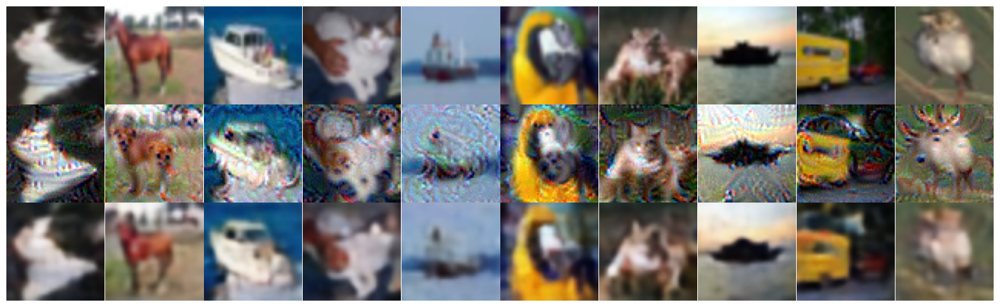

In [50]:
import matplotlib.pyplot as plt
import numpy as np

# Define a function to plot images for comparison
def plot_comparison(original_images, attacked_images, recon_images_best_model, n=15):
    fig, axes = plt.subplots(3, n, figsize=(20, 6))
    plt.subplots_adjust(wspace=0, hspace=0)  # Remove spaces between subplots
    for i in range(n):
        # Display original images
        axes[0, i].imshow(np.transpose(original_images[i], (1, 2, 0)))
        axes[0, i].axis('off')  # Hide axes

        # Display attacked images
        axes[1, i].imshow(np.transpose(attacked_images[i], (1, 2, 0)))
        axes[1, i].axis('off')  # Hide axes

        # Display reconstructed images from the best model
        axes[2, i].imshow(np.transpose(recon_images_best_model[i], (1, 2, 0)))
        axes[2, i].axis('off')  # Hide axes
    plt.show()

# Download and load the CIFAR-10 test dataset
test_dataset = datasets.CIFAR10('./data', train=False, transform=transform, download=True)
non_class_1_indices = [i for i, (_, label) in enumerate(test_dataset) if label != 1]
non_class_1_dataset = DataLoader(Subset(test_dataset, non_class_1_indices), batch_size=BATCH_SIZE, shuffle=True)

# Perform the attack and reconstruction
data, labels = next(iter(non_class_1_dataset))
data = data.to(device)
labels = labels.to(device)

eps = 0.5 # intensity is 0.5
alpha = 0.01
iters = 40


# Apply PGD attack to the original images
attacked_data = pgd_attack(cnn_model, data, labels, eps, alpha, iters)

# Pass the attacked images through the best model
with torch.no_grad():
    recon_batch_best_model = best_model(attacked_data)[0]

# Prepare the images for plotting
original_images = data.detach().cpu().numpy()
attacked_images = attacked_data.detach().cpu().numpy()
recon_images_best_model = recon_batch_best_model.detach().cpu().numpy()

# Call the plotting function
plot_comparison(original_images, attacked_images, recon_images_best_model, n=10)


Files already downloaded and verified


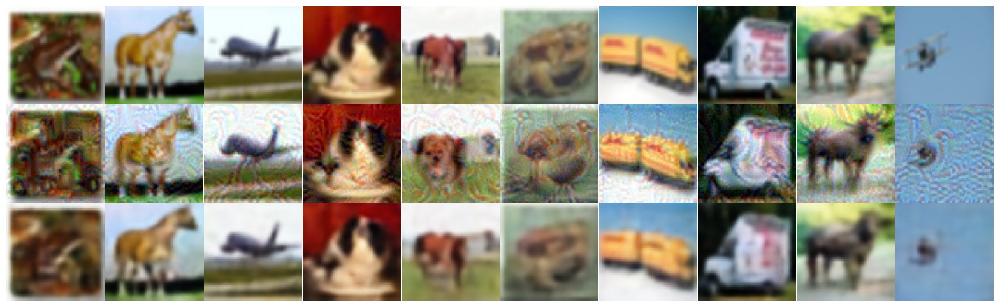

In [56]:
import matplotlib.pyplot as plt
import numpy as np

# Define a function to plot images for comparison
def plot_comparison(original_images, attacked_images, recon_images_best_model, n=15):
    fig, axes = plt.subplots(3, n, figsize=(20, 6))
    plt.subplots_adjust(wspace=0, hspace=0)  # Remove spaces between subplots
    for i in range(n):
        # Display original images
        axes[0, i].imshow(np.transpose(original_images[i], (1, 2, 0)))
        axes[0, i].axis('off')  # Hide axes

        # Display attacked images
        axes[1, i].imshow(np.transpose(attacked_images[i], (1, 2, 0)))
        axes[1, i].axis('off')  # Hide axes

        # Display reconstructed images from the best model
        axes[2, i].imshow(np.transpose(recon_images_best_model[i], (1, 2, 0)))
        axes[2, i].axis('off')  # Hide axes
    plt.show()

# Download and load the CIFAR-10 test dataset
test_dataset = datasets.CIFAR10('./data', train=False, transform=transform, download=True)
non_class_1_indices = [i for i, (_, label) in enumerate(test_dataset) if label != 1]
non_class_1_dataset = DataLoader(Subset(test_dataset, non_class_1_indices), batch_size=BATCH_SIZE, shuffle=True)

# Perform the attack and reconstruction
data, labels = next(iter(non_class_1_dataset))
data = data.to(device)
labels = labels.to(device)

eps = 0.1 # intensity is 0.5
alpha = 0.01
iters = 40


# Apply PGD attack to the original images
attacked_data = pgd_attack(cnn_model, data, labels, eps, alpha, iters)

# Pass the attacked images through the best model
with torch.no_grad():
    recon_batch_best_model = best_model(attacked_data)[0]

# Prepare the images for plotting
original_images = data.detach().cpu().numpy()
attacked_images = attacked_data.detach().cpu().numpy()
recon_images_best_model = recon_batch_best_model.detach().cpu().numpy()

# Call the plotting function
plot_comparison(original_images, attacked_images, recon_images_best_model, n=10)
